**Author:** Elias Rafael Ruiz-Morales

**Institution:** Wellcome Sanger institute

**July, 2023**

---

## Exploration of cellphoneDB results using ktplots

In [1]:
pip install  ktplotspy

     |████████████████████████████████| 1.3 MB 25.2 MB/s eta 0:00:01
  Using cached python_circos-0.3.0-py3-none-any.whl (27 kB)
     |████████████████████████████████| 9.2 MB 71.3 MB/s eta 0:00:01
  Using cached biopython-1.81-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.1 MB)
     |████████████████████████████████| 301 kB 82.4 MB/s eta 0:00:01
     |████████████████████████████████| 4.6 MB 74.2 MB/s eta 0:00:01
     |████████████████████████████████| 73 kB 917 kB/s  eta 0:00:01
  Using cached numpy-1.24.4-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.3 MB)
  Using cached statsmodels-0.14.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (10.2 MB)
  Using cached pandas-2.0.3-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.4 MB)
  Using cached backports.zoneinfo-0.2.1-cp38-cp38-manylinux1_x86_64.whl (74 kB)
  Using cached python_dateutil-2.8.2-py2.py3-none-any.whl (247 kB)
  Using cached tzdata-2023.3-py2.py3-none-any.whl (341 kB)
   

## for exploration only

In [2]:
import os
import anndata as ad
import pandas as pd
import ktplotspy as kpy
import matplotlib.pyplot as plt

In [3]:
from plotnine.ggplot import save_as_pdf_pages

In [115]:
# read in the files
# 1) .h5ad file used for performing cellphonedb
adata = ad.read_h5ad('../data/malaria_inf_normlogTransformed_24h.h5ad')


In [5]:
adata

AnnData object with n_obs × n_vars = 27100 × 36601
    obs: 'sample', 'stage', 'hpi', 'infection', 'percent_mito', 'n_counts', 'sample_barcode', 'assignment_SoC', 'donor_id', 'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'S_score', 'G2M_score', 'phase', 'n_genes_by_counts', 'total_counts', 'total_counts_hs', 'pct_counts_hs', 'total_counts_tg', 'pct_counts_tg', 'Tg_infected', 'n_genes', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden_scvi', 'celltype_predictions', 'probabilities', 'scrublet_doublet', 'cell_type_2022', 'cell_type', 'souporcell_MFgenotype', 'MFgenotype', 'cell_type_broad', 'umap_density_Tg_infected', 'stage_perInfection', 'celltype-Stage', 'Tg_intracellular', 'celltype-Intracellular', 'Dev_Stage'
    var: 'gene_ids', 'feature_types', 'mean-0', 'std-0', 'mean-1', 'std-1', 'mean-2', 'std-2', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Dev_Stage_colors', 'MFgenot

In [6]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_HBC_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_HBC_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_HBC_24h/deconvoluted.txt', sep = '\t')

In [10]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="HBC.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,41),
    title = "Malaria_HBC-log2FC0.1",
    highlight_size = 1,
    alpha=0.01,
    #default_style = False,
    standard_scale=True)


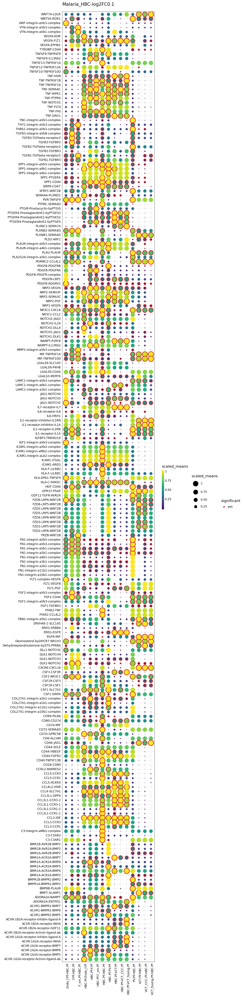

<Figure Size: (720 x 2952)>

In [11]:
plot2

In [12]:
plot2.save('../results/images/KTplot-Malaria-HBC-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 41 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-HBC-log2FC0.1.pdf


In [13]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_PAMM1_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_PAMM1_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_PAMM1_24h/deconvoluted.txt', sep = '\t')

In [14]:
plot2=kpy.plot_cpdb(
        adata=adata,
    cell_type1="PAMM1.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (11,21),
    title = "Malaria_PAMM1-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True
)    


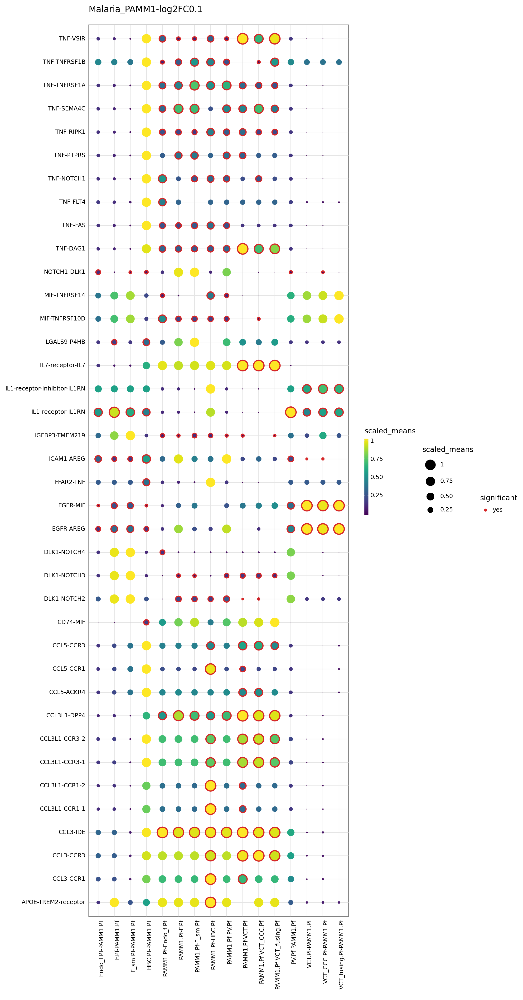

<Figure Size: (1100 x 2100)>

In [15]:
plot2

In [16]:
plot2.save('../results/images/KTplot-Malaria-PAMM1-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 11 x 21 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-PAMM1-log2FC0.1.pdf


In [17]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_F_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_F_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_F_24h/deconvoluted.txt', sep = '\t')

In [18]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="F.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (11,55),
    title = "Malaria_F-log2FC0.1",
    highlight_size = 1,
    alpha=0.01,
    #default_style = False,
    standard_scale=True)


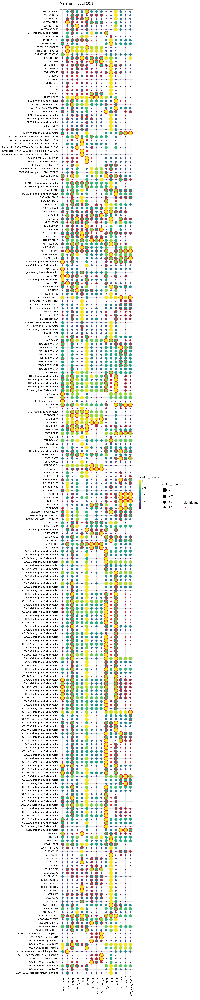

<Figure Size: (1100 x 5500)>

In [19]:
plot2

In [20]:
plot2.save('../results/images/KTplot-Malaria-F-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 11 x 55 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-F-log2FC0.1.pdf


In [21]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_Endof_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_Endof_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_Endof_24h/deconvoluted.txt', sep = '\t')

In [22]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="Endo_f.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (9,23),
    title = "Malaria_Endof-log2FC0.1",
    highlight_size = 1,
    alpha=0.01,
    #default_style = False,
    standard_scale=True)


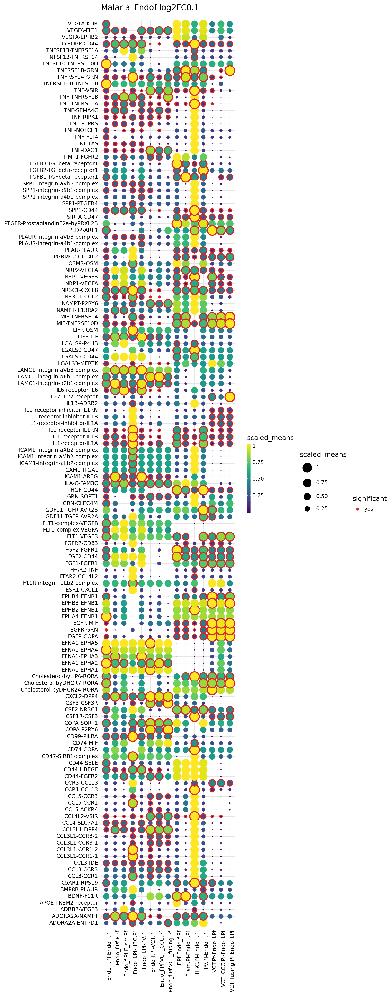

<Figure Size: (900 x 2300)>

In [23]:
plot2

In [24]:
plot2.save('../results/images/KTplot-Malaria-Endof-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 9 x 23 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-Endof-log2FC0.1.pdf


In [116]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_VCTfusing_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_VCTfusing_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_VCTfusing_24h/deconvoluted.txt', sep = '\t')

In [121]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT_fusing.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,23),
    title = "Malaria_VCTfusing-log2FC0.1",
    highlight_size = 1,
    alpha=0.01,
    #default_style = False,
    standard_scale=True)


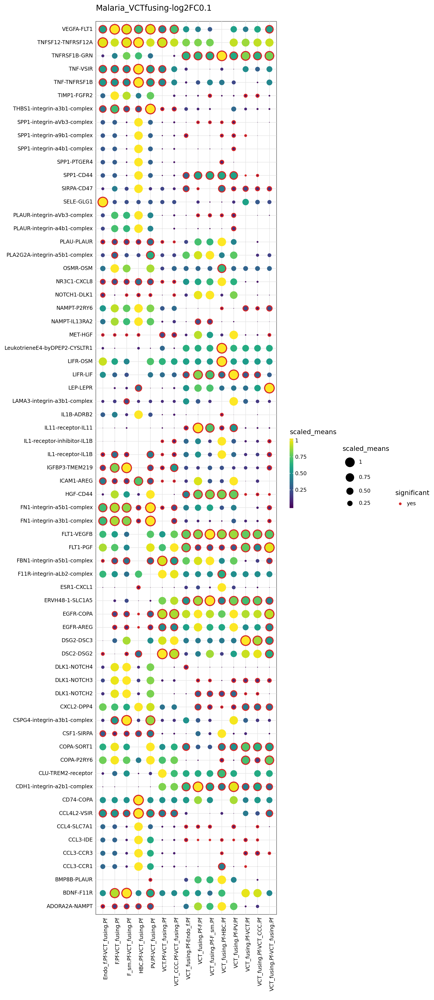

<Figure Size: (1000 x 2300)>

In [122]:
plot2

In [123]:
plot2.save('../results/images/KTplot-Malaria-VCTfusing-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 23 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-VCTfusing-log2FC0.1.pdf


In [124]:
# output from cellphonedb by celltypes
means = pd.read_csv('../results/out_inf_malaria_VCT_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_malaria_VCT_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_malaria_VCT_24h/deconvoluted.txt', sep = '\t')

In [128]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT.Pf",
    cell_type2="F.Pf|F_sm.Pf|PV.Pf|Endo_f.Pf|HBC.Pf|VCT.Pf|VCT_fusing.Pf|VCT_CCC.Pf", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,23),
    title = "Malaria_VCT-log2FC0.1",
    highlight_size = 1,
    alpha=0.01,
    #default_style = False,
    standard_scale=True)


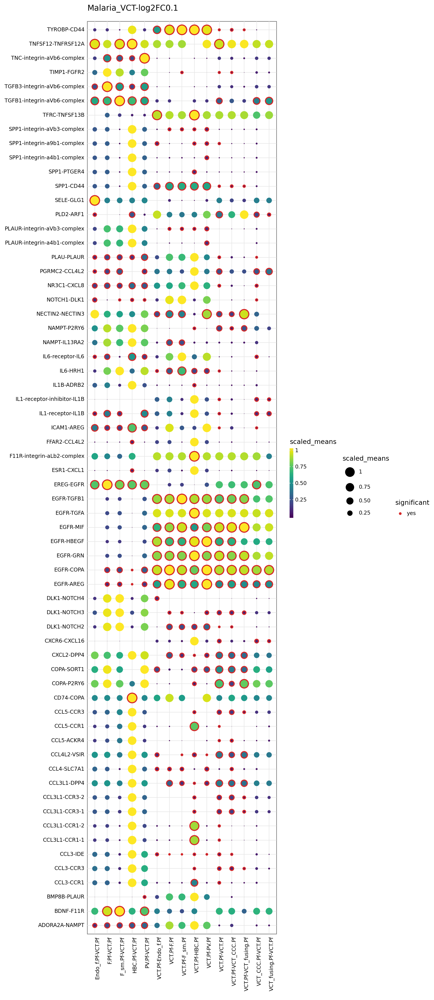

<Figure Size: (1000 x 2300)>

In [129]:
plot2

In [130]:
plot2.save('../results/images/KTplot-Malaria-VCT-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 23 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Malaria-VCT-log2FC0.1.pdf


# Toxoplasma

In [131]:
# read in the files
# 1) .h5ad file used for performing cellphonedb
adata = ad.read_h5ad('../data/toxoplasma_inf_normlogTransformed_24h.h5ad')


In [26]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_HBC_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_HBC_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_HBC_24h/deconvoluted.txt', sep = '\t')

In [27]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="HBC.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,23),
    title = "Toxoplasma_HBC-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


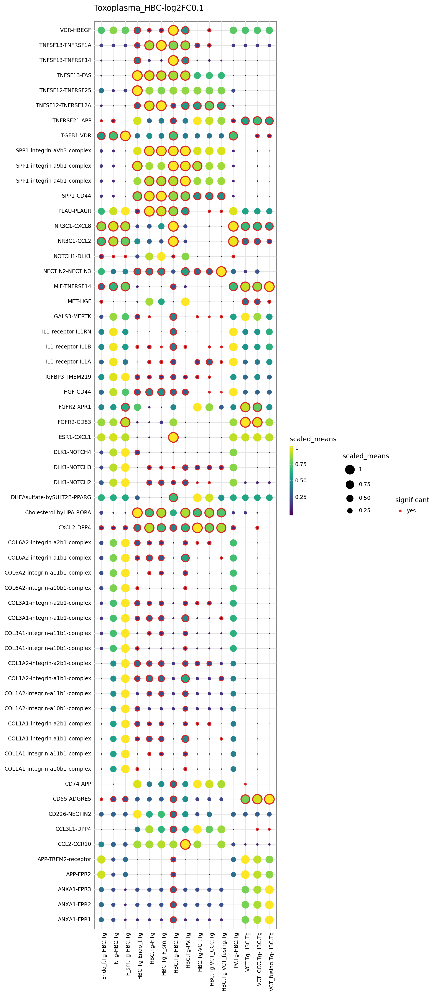

<Figure Size: (1000 x 2300)>

In [28]:
plot2

In [29]:
plot2.save('../results/images/KTplot-Toxoplasma-HBC-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 23 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Toxoplasma-HBC-log2FC0.1.pdf


In [94]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_PAMM1_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_PAMM1_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_PAMM1_24h/deconvoluted.txt', sep = '\t')

In [95]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="PAMM1.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (12,15),
    title = "Toxoplasma_PAMM1-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


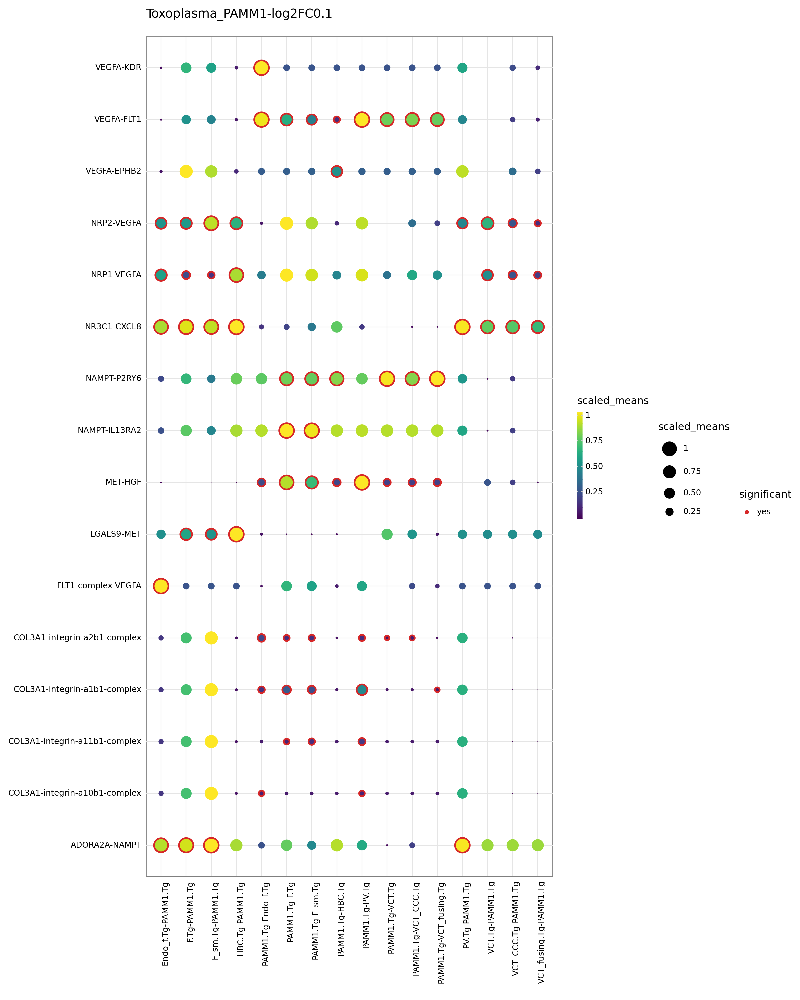

<Figure Size: (1200 x 1500)>

In [96]:
plot2

In [97]:
plot2.save('../results/images/KTplot-Toxoplasma-PAMM1-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 15 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Toxoplasma-PAMM1-log2FC0.1.pdf


In [34]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_F_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_F_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_F_24h/deconvoluted.txt', sep = '\t')

In [35]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="F.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,25),
    title = "Toxoplasma_F-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


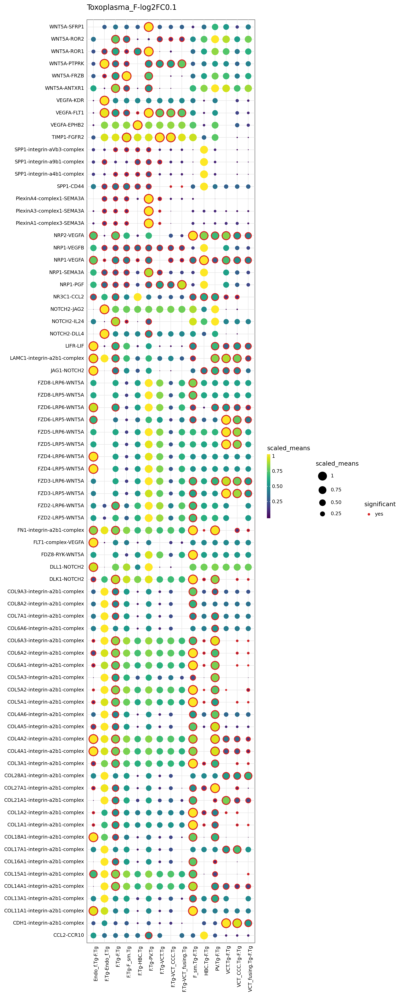

<Figure Size: (1000 x 2500)>

In [36]:
plot2

In [37]:
plot2.save('../results/images/KTplot-Toxoplasma-F-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 25 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Toxoplasma-F-log2FC0.1.pdf


In [112]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_Endof_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_Endof_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_Endof_24h/deconvoluted.txt', sep = '\t')

In [114]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="Endo_f.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,18),
    title = "Toxoplasma_Endof-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


KeyError: "['F.Tg>@<Endo_f.Tg', 'F_sm.Tg>@<Endo_f.Tg', 'HBC.Tg>@<Endo_f.Tg', 'PV.Tg>@<Endo_f.Tg'] not in index"

In [ ]:
plot2

In [ ]:
plot2.save('../results/images/KTplot-Toxoplasma-Endof-log2FC0.1.pdf', limitsize=False)

In [101]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_VCTfusing_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_VCTfusing_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_VCTfusing_24h/deconvoluted.txt', sep = '\t')

In [105]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT_fusing.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,15),
    title = "Toxoplasma_VCTfusing-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


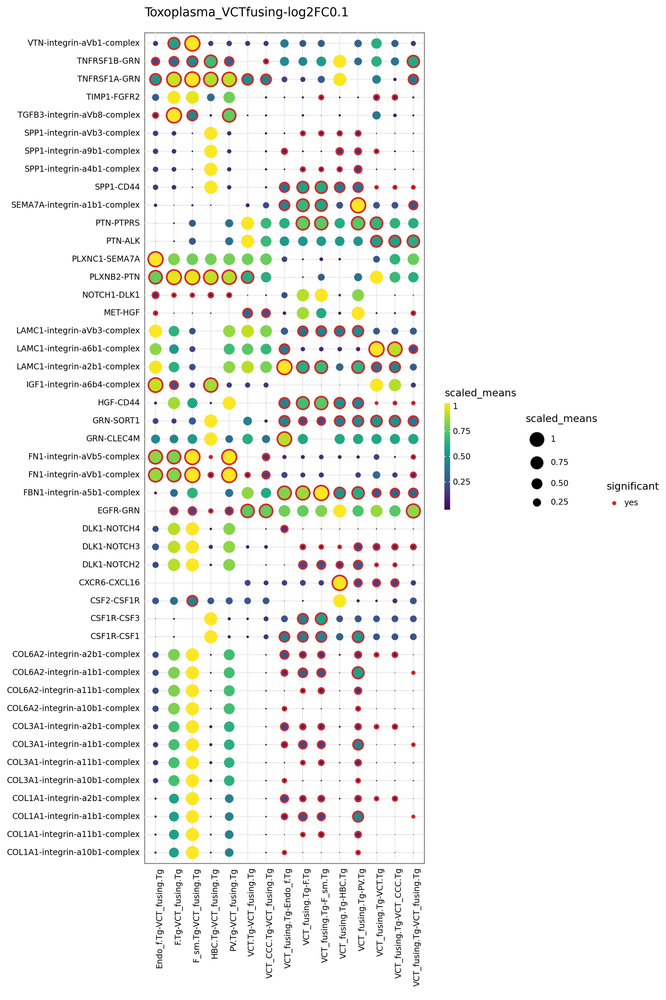

<Figure Size: (1000 x 1500)>

In [106]:
plot2

In [107]:
plot2.save('../results/images/KTplot-Toxoplasma-VCTfusing-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 15 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Toxoplasma-VCTfusing-log2FC0.1.pdf


In [108]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_toxoplasma_VCT_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_toxoplasma_VCT_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_toxoplasma_VCT_24h/deconvoluted.txt', sep = '\t')

In [109]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT.Tg",
    cell_type2="F.Tg|F_sm.Tg|PV.Tg|Endo_f.Tg|HBC.Tg|VCT.Tg|VCT_fusing.Tg|VCT_CCC.Tg", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,18),
    title = "Toxoplasma_VCT-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)


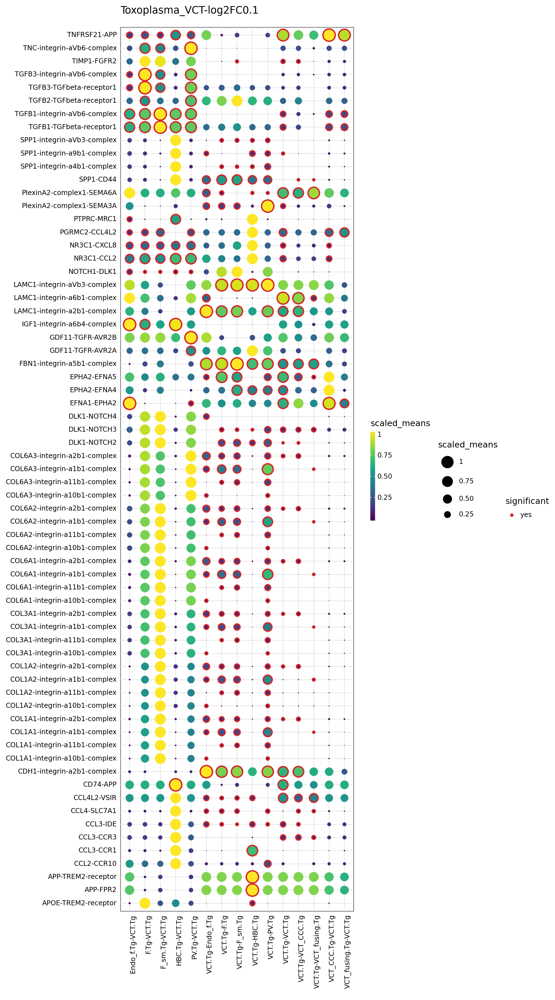

<Figure Size: (1000 x 1800)>

In [110]:
plot2

In [111]:
plot2.save('../results/images/KTplot-Toxoplasma-VCT-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 18 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Toxoplasma-VCT-log2FC0.1.pdf


# Listeria

In [45]:
# read in the files
# 1) .h5ad file used for performing cellphonedb
adata = ad.read_h5ad('../data/listeria_inf_normlogTransformed_24h.h5ad')


In [86]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_HBC_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_HBC_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_HBC_24h/deconvoluted.txt', sep = '\t')

In [90]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="HBC.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,40),
    title = "Listeria_HBC-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

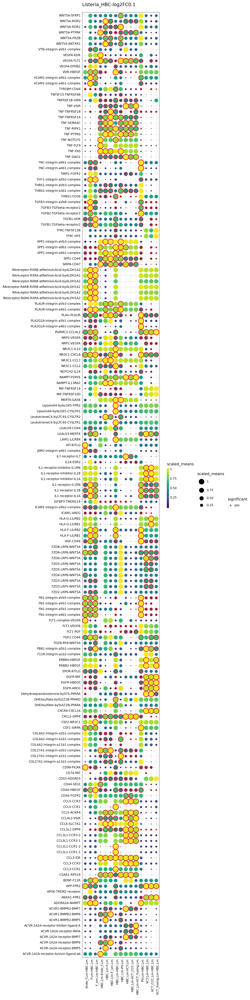

<Figure Size: (1000 x 4000)>

In [91]:
plot2

In [92]:
plot2.save('../results/images/KTplot-Listeria-HBC-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 40 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-HBC-log2FC0.1.pdf


In [82]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_PAMM1_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_PAMM1_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_PAMM1_24h/deconvoluted.txt', sep = '\t')

In [83]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="PAMM1.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,28),
    title = "Listeria_PAMM1-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

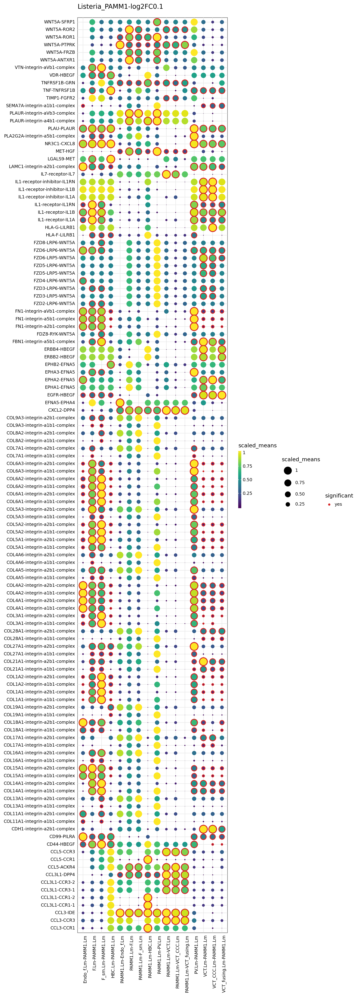

<Figure Size: (1000 x 2800)>

In [84]:
plot2

In [85]:
plot2.save('../results/images/KTplot-Listeria-PAMM1-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 28 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-PAMM1-log2FC0.1.pdf


In [54]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_F_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_F_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_F_24h/deconvoluted.txt', sep = '\t')

In [55]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="F.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,47),
    title = "Listeria_F-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

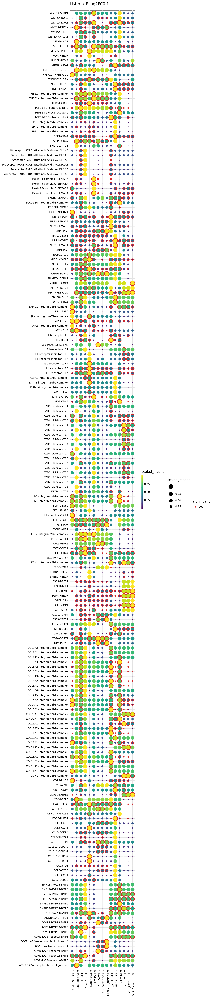

<Figure Size: (1000 x 4700)>

In [56]:
plot2

In [57]:
plot2.save('../results/images/KTplot-Listeria-F-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 47 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-F-log2FC0.1.pdf


In [58]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_Endof_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_Endof_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_Endof_24h/deconvoluted.txt', sep = '\t')

In [59]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="Endo_f.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,24),
    title = "Listeria_Endof-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

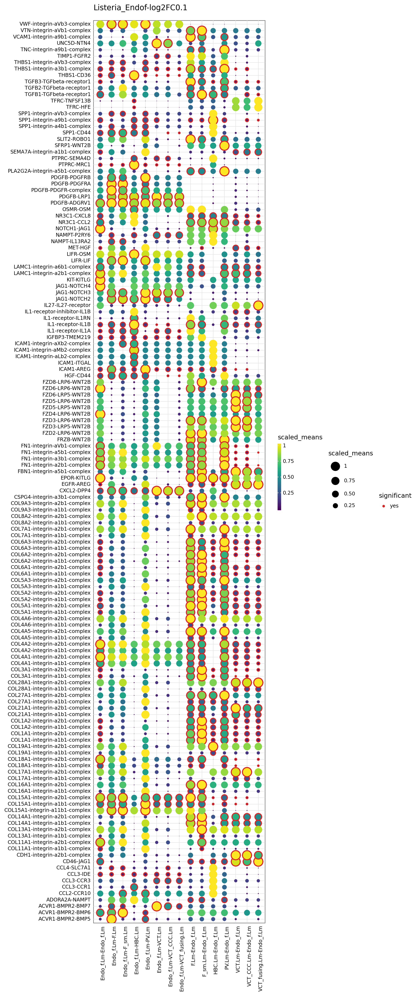

<Figure Size: (1000 x 2400)>

In [60]:
plot2

In [61]:
plot2.save('../results/images/KTplot-Listeria-Endof-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 24 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-Endof-log2FC0.1.pdf


In [71]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_VCTfusing_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_VCTfusing_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_VCTfusing_24h/deconvoluted.txt', sep = '\t')

In [72]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT_fusing.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,20),
    title = "Listeria_VCTfusing-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

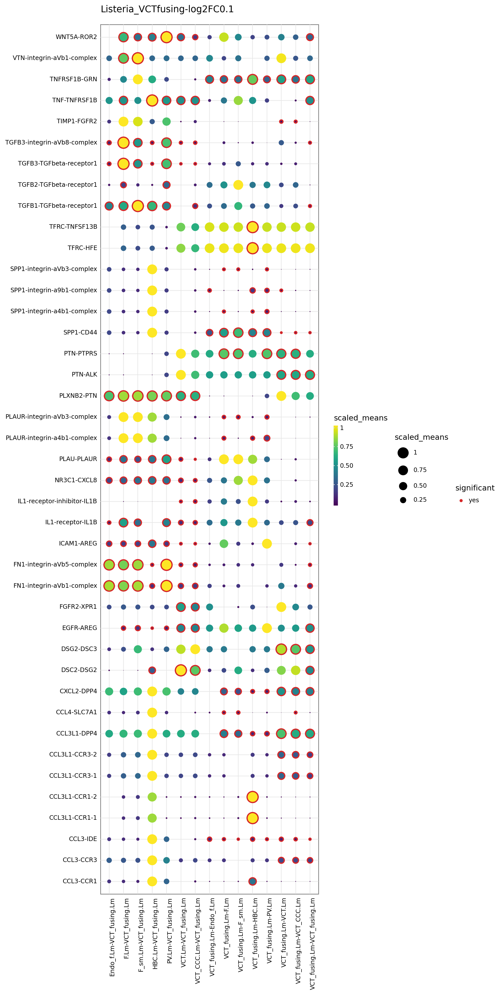

<Figure Size: (1000 x 2000)>

In [73]:
plot2

In [74]:
plot2.save('../results/images/KTplot-Listeria-VCTfusing-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 20 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-VCTfusing-log2FC0.1.pdf


In [75]:
# 2) output from cellphonedb
means = pd.read_csv('../results/out_inf_listeria_VCT_24h/means.txt', sep = '\t')
LR = pd.read_csv('../results/out_inf_listeria_VCT_24h/relevant_interactions.txt', sep = '\t')
decon = pd.read_csv('../results/out_inf_listeria_VCT_24h/deconvoluted.txt', sep = '\t')

In [79]:
plot2=kpy.plot_cpdb(
    adata=adata,
    cell_type1="VCT.Lm",
    cell_type2="F.Lm|F_sm.Lm|PV.Lm|Endo_f.Lm|HBC.Lm|VCT.Lm|VCT_fusing.Lm|VCT_CCC.Lm", # this means all cell-types
    means=means,
    degs_analysis=True,
    pvals=LR,
    celltype_key="cell_type",
    figsize = (10,40),
    title = "Listeria_VCT-log2FC0.1",
    highlight_size = 1,
    alpha=0.05,
    #default_style = False,
    standard_scale=True)

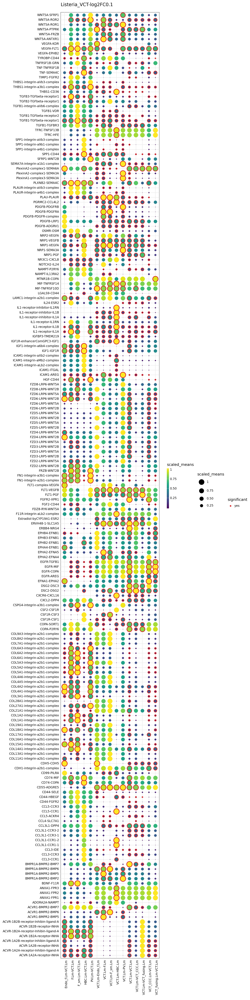

<Figure Size: (1000 x 4000)>

In [80]:
plot2

In [81]:
plot2.save('../results/images/KTplot-Listeria-VCT-log2FC0.1.pdf', limitsize=False)

/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 40 in image.
/opt/conda/lib/python3.8/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../results/images/KTplot-Listeria-VCT-log2FC0.1.pdf
